In [2]:
%load_ext autoreload
%autoreload 2

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import numpy as np
import math

from sklearn.mixture import GaussianMixture, BayesianGaussianMixture
from sklearn.decomposition import PCA

from groove.embedding import bar_embedding_freq, load_bar_embedding_freq,get_freq_segmented_transience, load_bar_embedding_total, bar_embedding_total, smooth_power
from groove.downbeats import get_measures, get_beat_frames, beat_peaks, get_beat_data, get_audio_data
from groove.intraclustering import get_ellipse_patch, get_patches, winnow_gm_components, ellipse_contains_points, find_closest_indices
import groove


def simulate_num_components(data, num_trials, confidence_limit=0.9, cluster_threshold=0.2, overlap_allowance=0.1, use_weights=False):
    counts = {}
    for _ in range(num_trials):
        n_components = winnow_gm_components(data, confidence_limit=confidence_limit, cluster_threshold=cluster_threshold, overlap_allowance=overlap_allowance, use_weights=use_weights).means_.shape[0]
        if n_components in counts:
            counts[n_components] += 1
        else:
            counts[n_components] = 1
    return counts




def do_clustering(data, confidence_limit=0.9, cluster_threshold=0.2, overlap_allowance=0.1, use_weights=False, verbose=False):
    gm = winnow_gm_components(data, confidence_limit=confidence_limit, cluster_threshold=cluster_threshold, overlap_allowance=overlap_allowance, use_weights=use_weights, verbose=verbose)
    print(f"Weights: {gm.weights_}")

    pca = PCA(n_components=2)
    pca.fit(data)
    print(f"PCA values: {pca.singular_values_}")

    return gm, pca

def do_projected_plot(gm, pca, data, confidence=0.9, data_list=None, file_list=None):

    red_data = pca.transform(data)
    patches, _ = get_patches(gm, confidence=confidence, pts=data, pca=pca)

    # Get axes min and max
    xlim = np.abs(red_data[:,0]).max() * 1.1
    ylim = np.abs(red_data[:,1]).max() * 1.1

    plt.figure(figsize=(8,8))
    ax = plt.gca()
    ax.set_xlim([-xlim, xlim])
    ax.set_ylim([-ylim, ylim])

    if data_list != None:
        cmap = mpl.colormaps['gist_rainbow'](np.linspace(0, 1, len(data_list)))
        #plt.cm.get_cmap('hsv', len(data_list)+1)

        running_total = 0
        legend_patches = []
        for i, d in enumerate(data_list):
            plt.scatter(red_data[running_total:running_total + d.shape[0],0], red_data[running_total:running_total + d.shape[0],1], alpha=0.5, color=cmap[i], s=3)
            running_total += d.shape[0]
            if file_list != None:
                legend_patches.append(mpatches.Patch(color=cmap[i], label=file_list[i][0]))
        if file_list != None:
            ax.legend(handles=legend_patches)
    else:
        plt.scatter(red_data[:,0], red_data[:,1], alpha=0.7)
    
    for p in patches:
        ax.add_patch(p)

    return patches


from IPython.display import Audio
from groove.downbeats import get_measures, get_beat_frames, beat_peaks
from groove.embedding import smooth_power
import librosa
from typing import Callable

def do_bar_sample(indices, file, process: Callable, ext="mp3"):
    raw_measures, proc_measures, sr = get_measures(file, process, ext)
    plot_bar_sample(indices, raw_measures, proc_measures, sr)
    return raw_measures, proc_measures, sr
def plot_bar_sample(indices, raw_measures, proc_measures, sr, grid=[16], labels=['lo','mid','hi']):
    norms = np.max(np.stack([np.max(proc,axis=0) for proc in proc_measures]), axis=0)
    
    for i in indices:
        raw, proc = raw_measures[i], proc_measures[i]
        #beat_frames = get_beat_frames([proc], sr, beat_peaks)[0][0]
        #clicks = librosa.clicks(times=beat_frames/sr, length=raw.shape[0], sr=sr)


        plt.figure(figsize=(20, 4))
        #plt.plot(raw)
        plt.plot(proc/norms,label=labels)
        for div in grid:
          for i in range(div):
            plt.vlines(i*len(proc)/div, 0,1, linestyles='dashed')
        plt.legend()
        #plt.scatter(beat_frames, np.zeros(beat_frames.shape), marker='o', color='red', zorder=10)
        display(Audio(data=raw, rate=sr))
        #display(Audio(data=raw + clicks, rate=sr))


In [6]:
file_list=[('01 Tame Impala - Let It Happen','m4a')]

In [54]:
# samples, sr = librosa.load('inputs/01 Tame Impala - Let It Happen.m4a')
LIH_beat_times = np.arange(4+5./24.8+30/sr, len(samples)/sr,60./125)
LIH_beats = np.array([(i%4) + 1. for i in range(len(LIH_beat_times))])
LIH_beat_data = np.vstack([LIH_beat_times,LIH_beats]).T

In [55]:
import groove.embedding

proc_fn = groove.embedding.smooth_power

# divs = np.array([3, 4, 6, 8, 9, 12, 15, 16, 18, 20, 21, 24])
divs = np.array([16])
# wts = 1/np.sqrt(divs)
# wts = 1/np.sqrt(divs)
wts=np.ones_like(divs)


# file_list = ['milaklaw', '06 Encore A', 'lms', ('09 D\'Angelo - Spanish Joint', 'm4a'), ('03 All the Pretty Girls', 'm4a')]
# file_list = [ ('06 Encore A','mp3'),  ('09 D\'Angelo - Spanish Joint', 'm4a'), ('03 All the Pretty Girls', 'm4a')]
# file_list=[('09 D\'Angelo - Spanish Joint', 'm4a')]
file_list=[('01 Tame Impala - Let It Happen','m4a')]

# Add extension
for i in range(len(file_list)):
    if type(file_list[i]) is not tuple:
        file_list[i] = (file_list[i], "mp3")

data_list = []
file_indices_list = []
indices_list = []
for i, (file, ext) in enumerate(file_list):
    data_list.append(load_bar_embedding_freq(file, divisions=divs, weights=wts, process=get_freq_segmented_transience,kernel_width=30, ext=ext,beat_data=LIH_beat_data))
    file_indices_list.append(np.full((data_list[i].shape[0],), i))
    indices_list.append(np.arange(data_list[i].shape[0]))

# Data, the index in file_list that the data came from, and the index inside its sublist
data = np.concatenate(data_list, axis=0)
data_file_inds = np.concatenate(file_indices_list, axis=0)
data_inds = np.concatenate(indices_list, axis=0)

/Users/duncan/Documents/code/erdos/groove_gang/groove/downbeats.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(f'inputs/{file}.{ext}')
/Users/duncan/mambaforge/envs/groove/lib/python3.11/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


Score: 214.1642086283195
Num components: 10
Score: 209.61612439582495
Num components: 10
Score: 215.28352985732425
Num components: 10
Overlaps 0.0
Containment [0.13333333 0.09166667 0.175      0.12916667 0.07916667 0.05416667
 0.07916667 0.07916667 0.0625     0.11666667]
Weights: [0.13333333 0.09166667 0.175      0.12916667 0.07916667 0.05416667
 0.07916667 0.07916667 0.0625     0.11666667]
PCA values: [1.44014584 0.93199289]


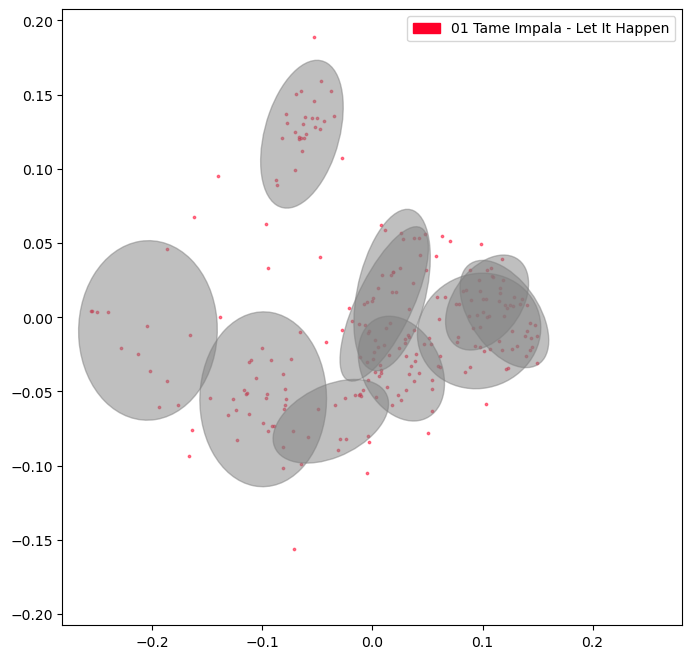

In [56]:
songind = 0
c = .8
gm, pca = do_clustering(data_list[songind], confidence_limit=c, cluster_threshold=0.05, overlap_allowance=1, use_weights=False, verbose=True)

do_projected_plot(gm, pca, data_list[songind], c, data_list=[data_list[songind]], file_list=[file_list[songind]])

In [74]:
cluster_ids = gm.predict(data_list[songind])
cluster_ids

array([9, 1, 4, 9, 1, 4, 9, 1, 4, 9, 1, 4, 9, 4, 4, 9, 1, 4, 9, 1, 4, 9,
       1, 3, 3, 3, 8, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 8, 0, 9,
       1, 4, 9, 1, 4, 9, 1, 4, 0, 8, 8, 8, 0, 8, 8, 0, 8, 9, 1, 0, 8, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 9, 1, 4, 9, 1, 4, 9,
       1, 4, 9, 1, 9, 9, 1, 4, 9, 1, 4, 9, 1, 4, 9, 1, 9, 9, 9, 4, 9, 1,
       4, 9, 1, 7, 9, 1, 9, 7, 7, 7, 7, 7, 7, 7, 7, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 7, 7, 7, 7, 7, 7, 7, 7, 0,
       0, 7, 0, 2, 2, 6, 2, 2, 6, 2, 2, 6, 2, 2, 5, 2, 5, 6, 5, 2, 6, 5,
       2, 6, 2, 2, 5, 2, 5, 6, 5, 2, 6, 5, 2, 6, 2, 2, 5, 2, 2, 6, 2, 2,
       6, 2, 2, 6, 2, 2, 5, 2, 5, 6, 5, 2, 6, 5, 2, 6, 2, 2, 7, 2, 2, 6,
       2, 2, 6, 2, 2, 6, 2, 2, 0, 2, 2, 6, 2, 0, 8, 8, 8, 8, 8, 8])

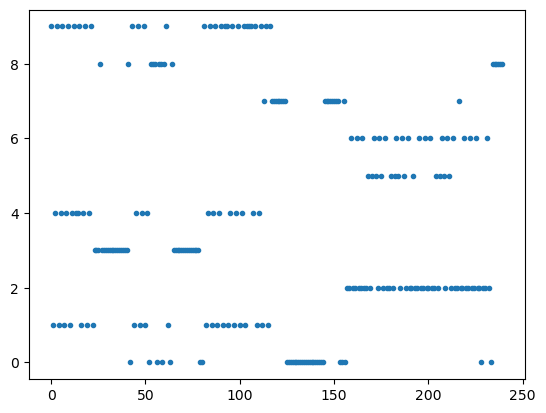

In [76]:
plt.plot(cluster_ids,linestyle="None", marker='.')

In [58]:
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext,beat_data=LIH_beat_data)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==1)[0]])
display(Audio(data=cluster_audio,rate=sr))

/Users/duncan/Documents/code/erdos/groove_gang/groove/downbeats.py:9: UserWarning: PySoundFile failed. Trying audioread instead.
  y, sr = librosa.load(f'inputs/{file}.{ext}')
/Users/duncan/mambaforge/envs/groove/lib/python3.11/site-packages/librosa/core/audio.py:184: FutureWarning: librosa.core.audio.__audioread_load
	Deprecated as of librosa version 0.10.0.
	It will be removed in librosa version 1.0.
  y, sr_native = __audioread_load(path, offset, duration, dtype)


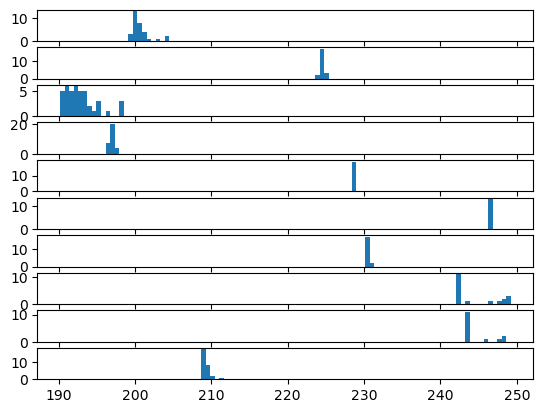

In [59]:
fig,axes  = plt.subplots( np.unique(cluster_ids).shape[0],1)
minval, maxval = np.percentile(gm.score_samples(data_list[songind]), (0,100))
bins=np.linspace(minval, maxval,100)
# bins=10
for c in np.unique(cluster_ids):
  axes[c].hist(gm.score_samples([data_list[songind][m] for m in np.where(cluster_ids==c)[0]]),bins=bins)

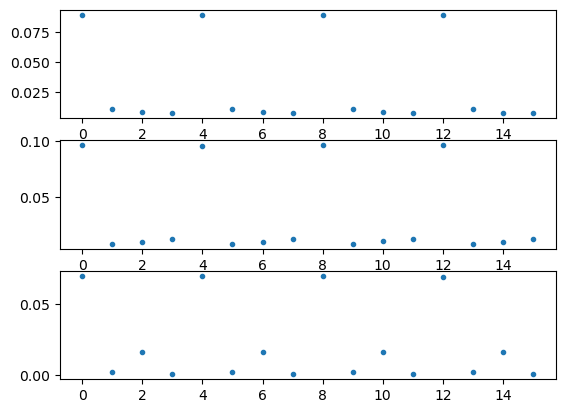

In [60]:
maxmeasure = np.where(gm.score_samples(data_list[songind])==maxval)[0][0]
enc = data_list[songind][maxmeasure].reshape(-1,3).T
fig,axes = plt.subplots(3,1)
axes[0].plot(enc[0],linestyle='None',marker='.')
axes[1].plot(enc[1],linestyle='None',marker='.')
axes[2].plot(enc[2],linestyle='None',marker='.')
plt.show()
cluster_audio = raw_measures[maxmeasure]
display(Audio(data=cluster_audio,rate=sr))


In [61]:
def plot_enc(enc):
  # maxmeasure = np.where(gm.score_samples(data_list[songind])==maxval)[0][0]

  enc = enc.reshape(-1,3).T
  fig,axes = plt.subplots(3,1)
  axes[0].plot(enc[0],linestyle='None',marker='.')
  axes[1].plot(enc[1],linestyle='None',marker='.')
  axes[2].plot(enc[2],linestyle='None',marker='.')
  plt.show()
  # cluster_audio = raw_measures[maxmeasure]
  # display(Audio(data=cluster_audio,rate=sr))


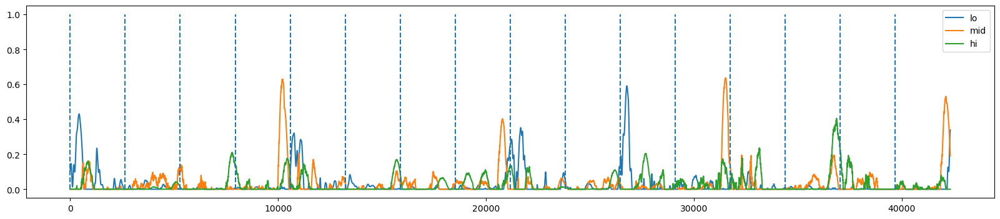

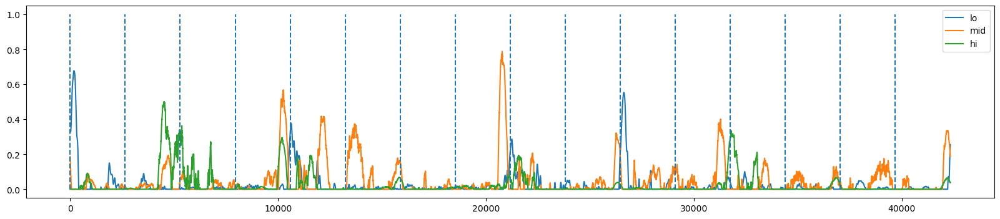

In [62]:
plot_bar_sample([20,21],raw_measures, proc_measures,sr )

In [63]:
unique, counts = np.unique(cluster_ids, return_counts=True)
print(unique)
print(counts)

[0 1 2 3 4 5 6 7 8 9]
[32 22 42 31 19 13 19 19 15 28]


In [64]:
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==1)[0]])
display(Audio(data=cluster_audio,rate=sr))

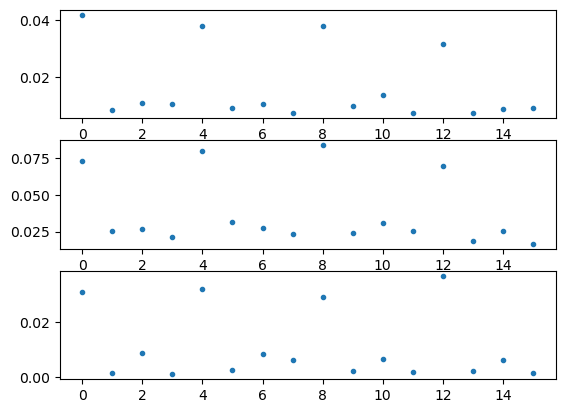

In [65]:
cluster_id = 0
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))

plot_enc(gm.means_[cluster_id])

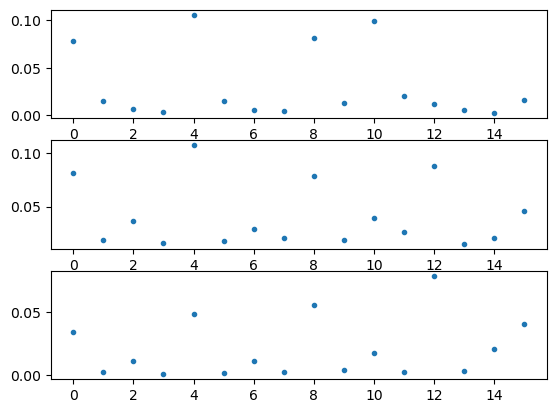

In [66]:
cluster_id = 1
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))

plot_enc(gm.means_[cluster_id])

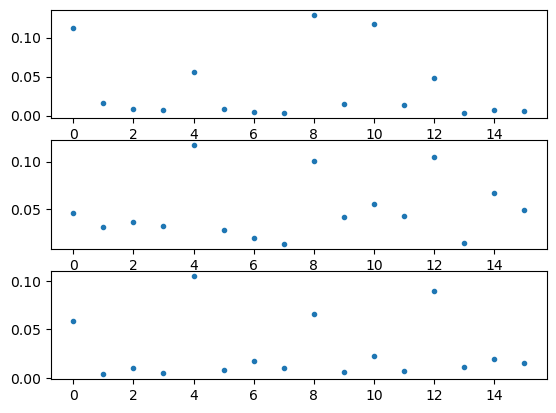

In [67]:
cluster_id = 2
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))
plot_enc(gm.means_[cluster_id])

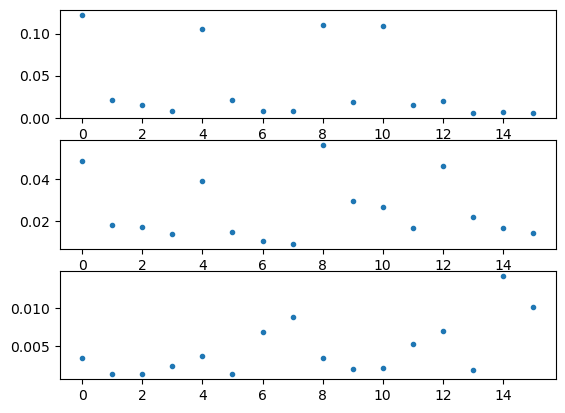

In [68]:
cluster_id = 3
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))

plot_enc(gm.means_[cluster_id])

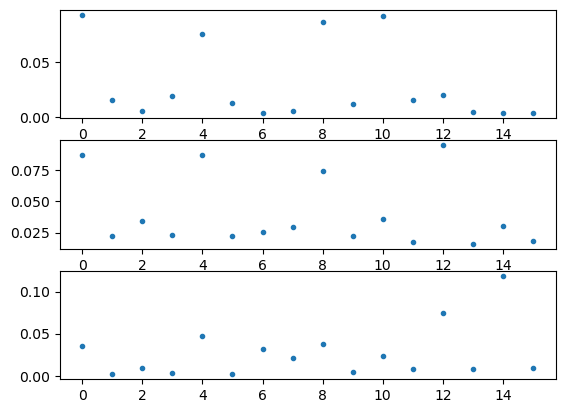

In [69]:
cluster_id = 4
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))

plot_enc(gm.means_[cluster_id])

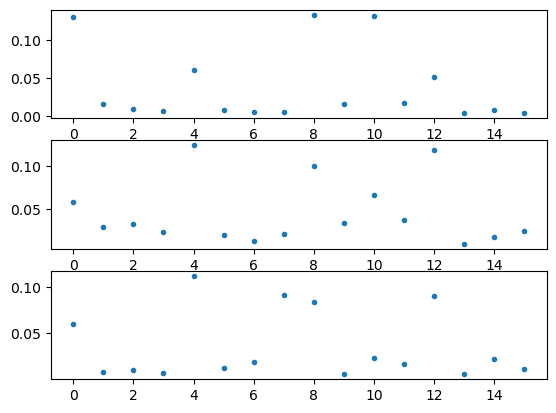

In [71]:
cluster_id = 5
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))

plot_enc(gm.means_[cluster_id])

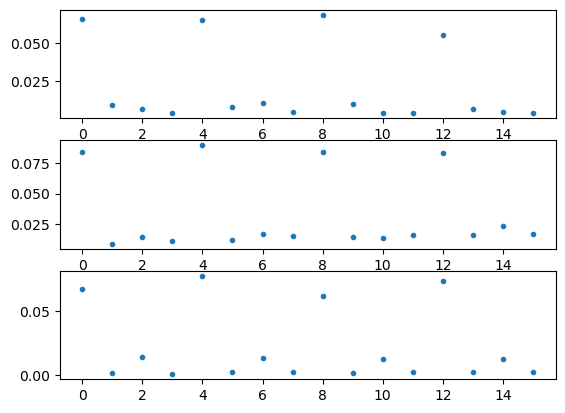

In [72]:
cluster_id = 7
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))

plot_enc(gm.means_[cluster_id])

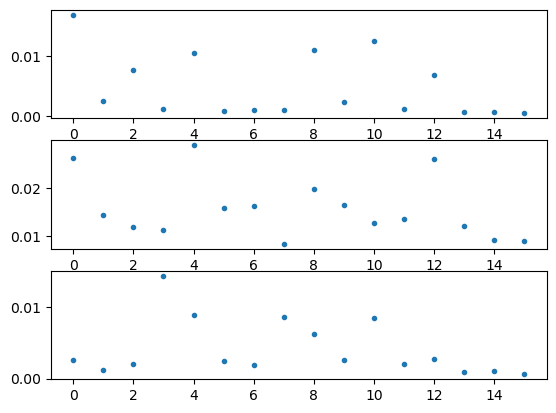

In [73]:
cluster_id = 8
filename=file_list[songind][0]
ext =file_list[songind][1]

# samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])
# clipstart = int(len(samples)*start/len(enc))
# clipend= int(len(samples)*end/len(enc))
# raw_measures, proc_measures, sr = get_measures(filename, get_freq_segmented_transience, ext)
cluster_audio = np.concatenate([raw_measures[i] for i in np.where(cluster_ids==cluster_id)[0]])
display(Audio(data=cluster_audio,rate=sr))

plot_enc(gm.means_[cluster_id])

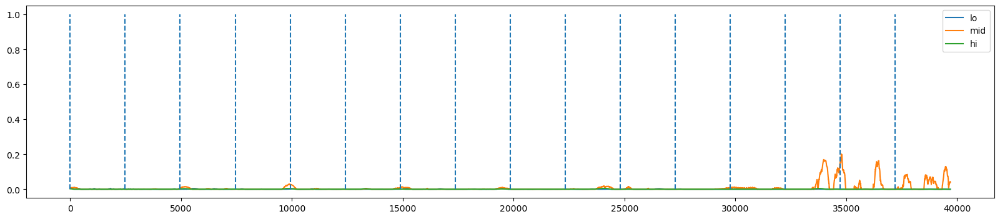

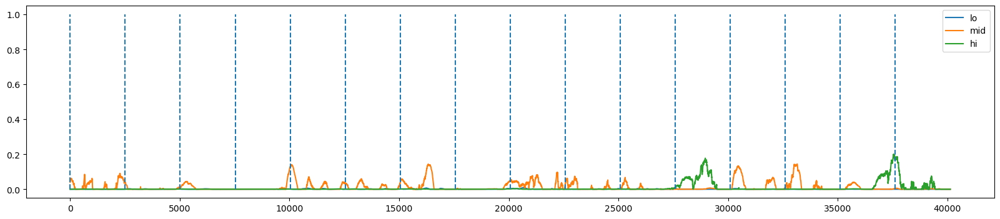

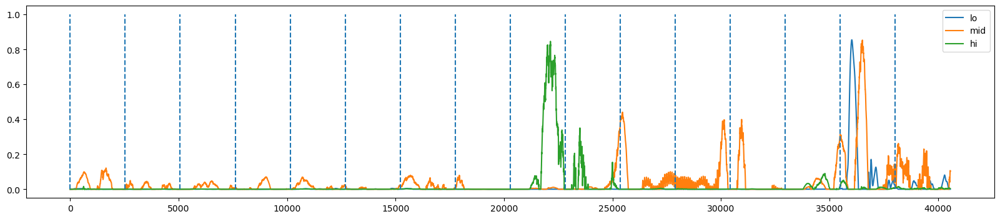

In [14]:
raws,procs,sr = do_bar_sample([0,1,2], file_list[songind][0], process=get_freq_segmented_transience, ext=file_list[songind][1])

Score: 244.26820770227408
Num components: 10
Score: 244.8836046053589
Num components: 10
Score: 244.06731010713656
Num components: 10
Overlaps 0.46632124352331605
Containment [0.11917098 0.24870466 0.17098446 0.05440415 0.21761658 0.1373057
 0.05958549 0.51295337 0.0880829  0.0388601 ]
Failed because some clusters beneath required coverage 0.09999999999999999.
Score: 243.3779744835287
Num components: 9
Score: 243.91206845441107
Num components: 9
Score: 242.77976679418472
Num components: 9
Overlaps 0.5880829015544041
Containment [0.22797927 0.47668394 0.19430052 0.11917098 0.56994819 0.12694301
 0.05958549 0.08549223 0.03626943]
Failed because some clusters beneath required coverage 0.09999999999999999.
Score: 242.34533026379304
Num components: 8
Score: 242.95253206746787
Num components: 8
Score: 242.50668163675172
Num components: 8
Overlaps 0.4844559585492228
Containment [0.14248705 0.1761658  0.21761658 0.22020725 0.11398964 0.46632124
 0.18393782 0.3238342 ]
Weights: [0.08549318 0.06

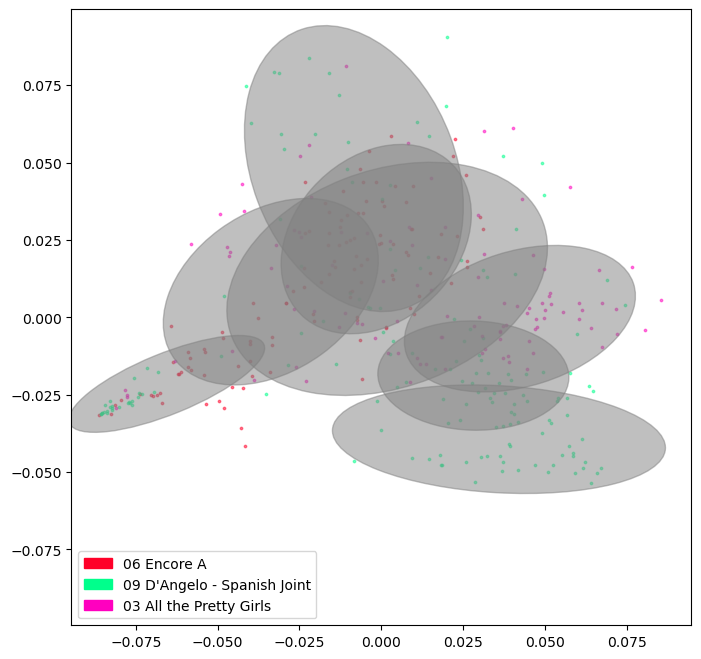

In [3]:
#c = .8
#gm, pca = do_clustering(data, confidence_limit=c, cluster_threshold=0.3, overlap_allowance=0.2, use_weights=False, verbose=True)

c = .8
gm, pca = do_clustering(data, confidence_limit=c, cluster_threshold=0.3/len(file_list), overlap_allowance=1, use_weights=False, verbose=True)

do_projected_plot(gm, pca, data, c, data_list=data_list, file_list=file_list)

Score: 244.00893317313103
Num components: 10
Score: 243.63816373469294
Num components: 10
Score: 244.08772826315032
Num components: 10
Overlaps 0.533678756476684
Containment [0.39119171 0.16062176 0.03626943 0.08549223 0.29533679 0.40932642
 0.17357513 0.10362694 0.03367876 0.07772021]
Failed because some clusters beneath required coverage 0.09999999999999999.
Score: 243.46374985459605
Num components: 9
Score: 243.17505164272944
Num components: 9
Score: 243.76225562071156
Num components: 9
Overlaps 0.3238341968911917
Containment [0.18911917 0.11398964 0.10103627 0.06735751 0.4507772  0.18134715
 0.03367876 0.14248705 0.11658031]
Failed because some clusters beneath required coverage 0.09999999999999999.
Score: 242.69347498117992
Num components: 8
Score: 242.9706138672371
Num components: 8
Score: 242.5317643793311
Num components: 8
Overlaps 0.48186528497409326
Containment [0.14766839 0.47150259 0.14507772 0.21243523 0.19430052 0.20725389
 0.05699482 0.35751295]
Failed because some clust

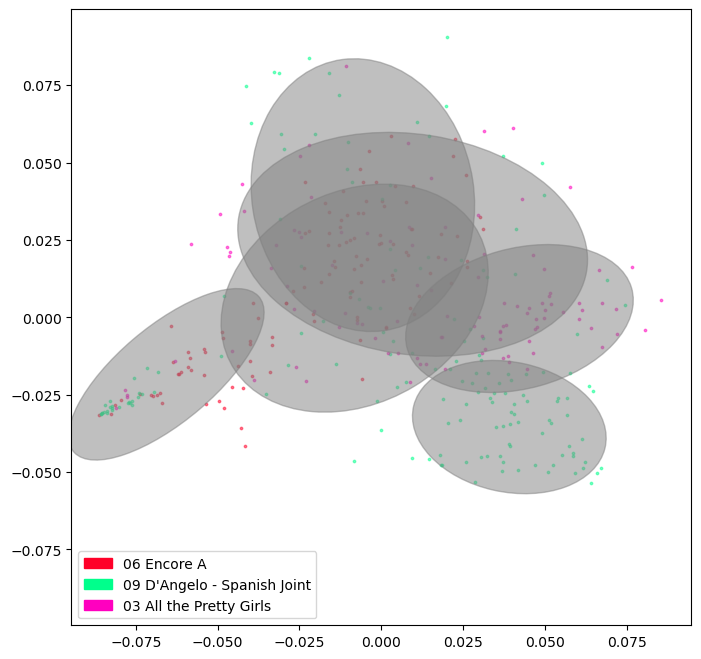

In [4]:
#c = .8
#gm, pca = do_clustering(data, confidence_limit=c, cluster_threshold=0.3, overlap_allowance=0.2, use_weights=False, verbose=True)

c = .8
gm, pca = do_clustering(data, confidence_limit=c, cluster_threshold=0.3/len(file_list), overlap_allowance=1, use_weights=False, verbose=True)

do_projected_plot(gm, pca, data, c, data_list=data_list, file_list=file_list)

Score: 243.96233935907065
Num components: 10
Score: 243.90087259850293
Num components: 10
Score: 244.13580503581704
Num components: 10
Overlaps 0.538860103626943
Containment [0.19170984 0.18393782 0.15803109 0.42227979 0.11917098 0.03367876
 0.13989637 0.05958549 0.02849741 0.46632124]
Failed because some clusters beneath required coverage 0.09999999999999999.
Score: 243.63784590886925
Num components: 9
Score: 243.51500133989893
Num components: 9
Score: 242.9506820605093
Num components: 9
Overlaps 0.5129533678756477
Containment [0.48445596 0.16839378 0.13212435 0.18134715 0.43264249 0.03367876
 0.08031088 0.14248705 0.13989637]
Failed because some clusters beneath required coverage 0.09999999999999999.
Score: 242.73182539933026
Num components: 8
Score: 242.7628429490756
Num components: 8
Score: 242.02497439213505
Num components: 8
Overlaps 0.5984455958549223
Containment [0.13471503 0.3626943  0.06735751 0.44300518 0.06476684 0.50518135
 0.13989637 0.1761658 ]
Failed because some cluste

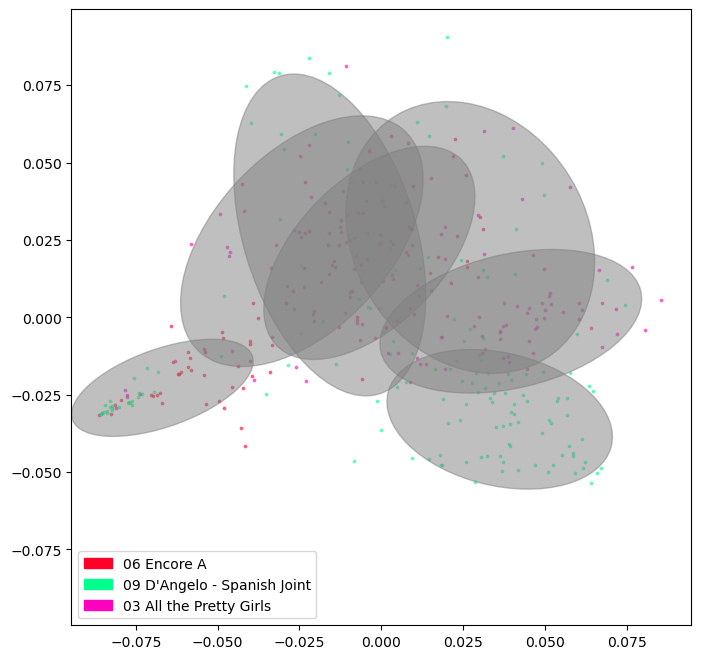

In [5]:
#c = .8
#gm, pca = do_clustering(data, confidence_limit=c, cluster_threshold=0.3, overlap_allowance=0.2, use_weights=False, verbose=True)

c = .8
gm, pca = do_clustering(data, confidence_limit=c, cluster_threshold=0.3/len(file_list), overlap_allowance=1, use_weights=False, verbose=True)

do_projected_plot(gm, pca, data, c, data_list=data_list, file_list=file_list)

In [28]:
data_list[0]

array([[1.26685453e-01, 3.01173511e-01, 2.40610366e-01, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [9.76538766e-02, 9.81482559e-02, 2.08851870e-03, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [2.02807398e-01, 2.33271279e-01, 1.68913577e-01, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       ...,
       [7.41130834e-03, 1.18200528e-03, 1.42909845e-03, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [5.54322011e-02, 4.17972165e-02, 4.14627707e-02, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.03652946e-05, 2.14787555e-05, 1.69354986e-05, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00]])

In [84]:
enc = np.concatenate(data_list[0])

In [85]:
enc.reshape(-1,16,3)

array([[[8.95126225e-03, 2.12801313e-02, 1.70008981e-02],
        [3.49022018e-03, 2.98555409e-03, 7.22438918e-03],
        [6.72402155e-03, 9.93771725e-03, 8.37596316e-03],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

       [[6.89996710e-03, 6.93489865e-03, 1.47569260e-04],
        [9.18507159e-03, 1.26553504e-02, 3.81234296e-03],
        [9.72887815e-03, 9.40641313e-03, 5.48362277e-03],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00]],

       [[1.43298395e-02, 1.64823375e-02, 1.19349909e-02],
        [8.36918328e-03, 2.32068455e-02, 2.20551837e-02],
        [1.11970850e-02, 8.56723531e-03, 3.65601241e-03],
        ...,
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00

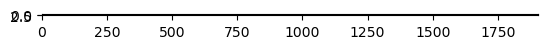

In [86]:
plt.imshow(enc.reshape(3,-1)[:10])

In [87]:
filename='inputs/'+file_list[0][0]
samples,sr= librosa.load('inputs/'+file_list[0][0]+'.'+file_list[0][1])

[src/libmpg123/id3.c:process_comment():587] error: No comment text / valid description?


In [88]:
samples

array([-9.5113264e-06, -1.4201519e-05,  6.7243809e-06, ...,
       -7.6061009e-15,  6.2172489e-15, -5.3290705e-15], dtype=float32)

In [89]:
clipend-clipstart

100666464

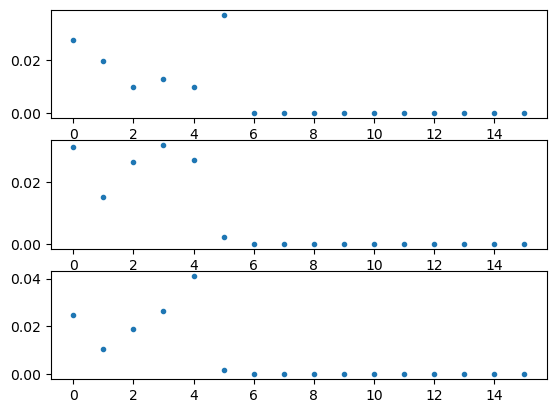

In [90]:
fig, axes = plt.subplots(3,1)
start=16*3*40
end=start+16*3
axes[0].plot(enc[start:end:3],linestyle='None',marker='.')
axes[1].plot(enc[start+1:end:3],linestyle='None',marker='.')
axes[2].plot(enc[start+2:end:3],linestyle='None',marker='.')
clipstart = int(len(samples)*start/len(enc))
clipend= int(len(samples)*end/len(enc))
display(Audio(data=samples[clipstart:clipend],rate=sr))

In [62]:
Audio?

Init signature:
Audio(
    data=None,
    filename=None,
    url=None,
    embed=None,
    rate=None,
    autoplay=False,
    normalize=True,
    *,
    element_id=None,
)
Docstring:     
Create an audio object.

When this object is returned by an input cell or passed to the
display function, it will result in Audio controls being displayed
in the frontend (only works in the notebook).

Parameters
----------
data : numpy array, list, unicode, str or bytes
    Can be one of

      * Numpy 1d array containing the desired waveform (mono)
      * Numpy 2d array containing waveforms for each channel.
        Shape=(NCHAN, NSAMPLES). For the standard channel order, see
        http://msdn.microsoft.com/en-us/library/windows/hardware/dn653308(v=vs.85).aspx
      * List of float or integer representing the waveform (mono)
      * String containing the filename
      * Bytestring containing raw PCM data or
      * URL pointing to a file on the web.

    If the array option is used, the waveform

In [19]:
enc

array([[0.20882863, 0.14658203, 0.06599536, ..., 0.        , 0.        ,
        0.        ],
       [0.00751019, 0.00631652, 0.00569439, ..., 0.        , 0.        ,
        0.        ],
       [0.00177685, 0.00382545, 0.00586907, ..., 0.        , 0.        ,
        0.        ],
       ...,
       [0.01834441, 0.05037334, 0.07243547, ..., 0.        , 0.        ,
        0.        ],
       [0.01624448, 0.01817496, 0.01545566, ..., 0.        , 0.        ,
        0.        ],
       [0.00724129, 0.00655837, 0.00548191, ..., 0.        , 0.        ,
        0.        ]])

In [25]:
enc.reshape(-1,3)[5000:5200,0]

array([], dtype=float64)

[src/libmpg123/id3.c:process_comment():587] error: No comment text / valid description?
/var/folders/5s/5m5dcls13_scn11gch5x16680000gn/T/ipykernel_17994/3110962910.py:97: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  plt.legend()


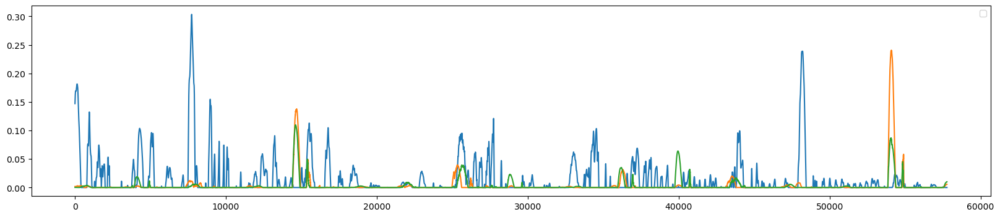

In [125]:
raws,procs,sr = do_bar_sample([100], "06 Encore A", process=get_freq_segmented_transience, ext="mp3")

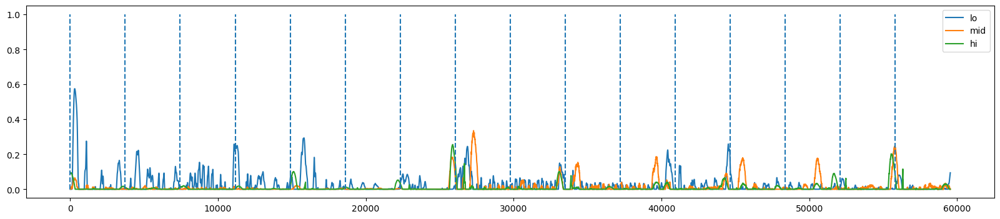

In [136]:
plot_bar_sample([81],raws,procs,sr )

In [88]:
raws[-1].shape

(29988,)

In [82]:
len(procs)

119

In [147]:
procs = get_freq_segmented_transience(samples,framerate=sr)

In [141]:
procs.shape

(6291654, 3)

In [97]:
_ = procs[:10]

In [98]:
list(map(print,_))

[7.19538019e-11 2.40945320e-21 2.02840144e-09]
[7.26546221e-11 2.41143334e-21 2.03440709e-09]
[7.33554708e-11 2.41487195e-21 2.04228083e-09]
[7.40560629e-11 2.42282544e-21 2.04958434e-09]
[7.47560781e-11 2.42550774e-21 2.05069647e-09]
[7.54551589e-11 2.41879981e-21 2.04715656e-09]
[7.61529063e-11 2.41082098e-21 2.05434419e-09]
[7.68488765e-11 2.41508051e-21 2.03557912e-09]
[7.75425773e-11 2.41673832e-21 1.97098535e-09]
[7.82334656e-11 2.40306220e-21 1.95173814e-09]


[None, None, None, None, None, None, None, None, None, None]

In [138]:
max([np.max(proc,axis=0) for proc in procs])

ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [119]:
np.max(np.stack([np.max(proc,axis=0) for proc in procs]), axis=0)

array([1.41528032e+01, 9.61447577e-12, 3.09225488e-01])

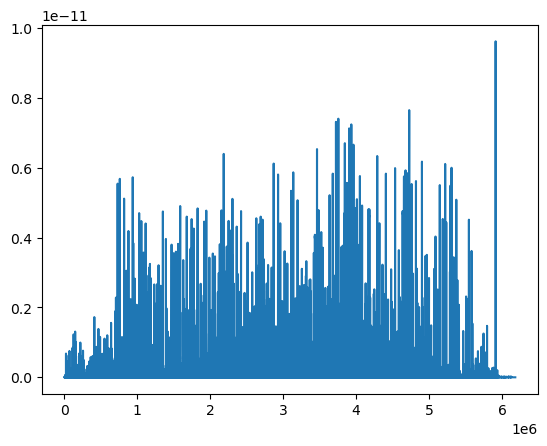

In [121]:
plt.plot(np.concatenate([proc[:,1] for proc in procs]))

In [120]:
procs

[array([[2.65416803e-01, 0.00000000e+00, 1.80338672e-03],
        [2.68110058e-01, 0.00000000e+00, 1.79439485e-03],
        [2.70863711e-01, 0.00000000e+00, 1.76189286e-03],
        ...,
        [1.12998311e-01, 1.09683413e-15, 0.00000000e+00],
        [1.09218110e-01, 1.16349547e-15, 0.00000000e+00],
        [1.05302853e-01, 1.23715450e-15, 0.00000000e+00]]),
 array([[1.01282716e-01, 1.43947477e-15, 0.00000000e+00],
        [9.71885755e-02, 1.74753723e-15, 0.00000000e+00],
        [9.30517995e-02, 2.05299839e-15, 0.00000000e+00],
        ...,
        [0.00000000e+00, 8.30259407e-15, 6.18742255e-05],
        [0.00000000e+00, 9.43048953e-15, 6.47036820e-05],
        [0.00000000e+00, 1.03995553e-14, 6.60783311e-05]]),
 array([[0.00000000e+00, 1.08821023e-14, 6.88448108e-05],
        [0.00000000e+00, 1.08235234e-14, 7.12865662e-05],
        [0.00000000e+00, 1.05320997e-14, 7.38124768e-05],
        ...,
        [0.00000000e+00, 3.12492671e-14, 0.00000000e+00],
        [0.00000000e+00, 3.16

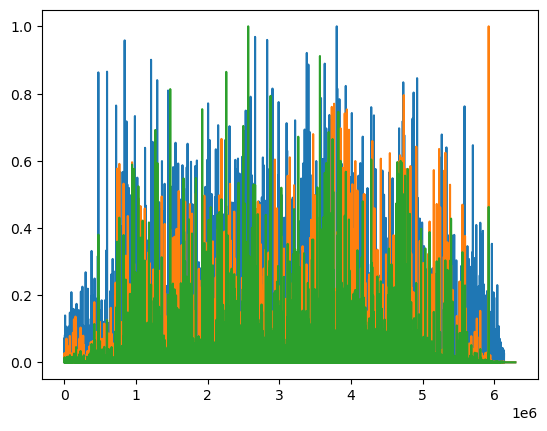

In [146]:
plt.plot(procs/np.max(procs,axis=0))

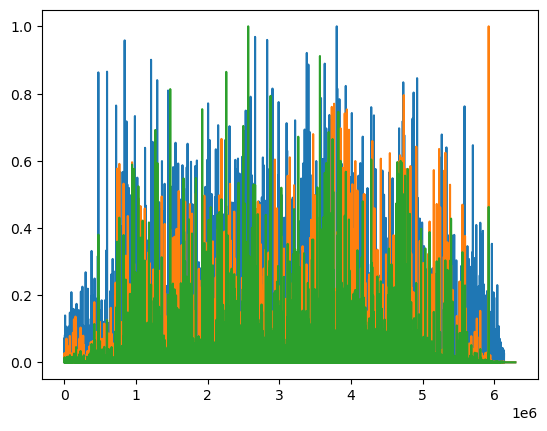

In [148]:
plt.plot(procs)